In [1]:
import numpy as np
import time, os, sys
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300
from cellpose import utils, io
import h5py
import os
from tqdm import tqdm
import tifffile

cube = 9

marker_names = ["DNA1","PD1","TLR3","SOX10","DNA2","CD163",
"CD3D","PDL1","DNA3","CD4","ICOS","HLADPB1","DNA4","CD8A",
"CD68","GZMB","DNA5","CD40L","LAG3","HLAA","DNA6","SQSTM",
"VIN","TIM3","DNA7","LAMP1/CD107A","PDL1_2","PD1_2"]

file = "../data/raw/{}_R3D_D3D_3D_MERGED.tiff".format(cube)
with h5py.File("../data/9_better.h5", "r") as f:
    dna_img = np.array(f["img"])[20:75,:,:]

from cellpose import models, io
model = models.Cellpose(gpu=True, model_type='nuclei')
chan = [0,0]
#dna_img = img[20:75,0,:,:]
masks, flows, styles, diams = model.eval(dna_img, channels=chan, do_3D=True, diameter=85)


CUDA version not installed/working, will use CPU version.
>>>> using CPU
multi-stack tiff read in as having 35 planes 1 channels
processing 1 image(s)


/opt/homebrew/anaconda3/envs/melanoma_analysis/lib/python3.10/site-packages/cellpose/transforms.py:171: RuntimeWarning: divide by zero encountered in true_divide
  X = (X - np.percentile(X, 1)) / (np.percentile(X, 99) - np.percentile(X, 1))
/opt/homebrew/anaconda3/envs/melanoma_analysis/lib/python3.10/site-packages/cellpose/transforms.py:171: RuntimeWarning: invalid value encountered in true_divide
  X = (X - np.percentile(X, 1)) / (np.percentile(X, 99) - np.percentile(X, 1))



 running YX: 35 planes of size (1024, 1024) 




100%|██████████| 18/18 [01:56<00:00,  6.49s/it]



 running ZY: 1024 planes of size (35, 1024) 




100%|██████████| 512/512 [56:35<00:00,  6.63s/it] 



 running ZX: 1024 planes of size (35, 1024) 




 70%|██████▉   | 356/512 [1:40:20<16:57,  6.52s/it]     

4 -color algorthm failed,trying again with 5 colors. Depth 0
4 -color algorthm failed,trying again with 5 colors. Depth 0
4 -color algorthm failed,trying again with 5 colors. Depth 0
4 -color algorthm failed,trying again with 5 colors. Depth 0


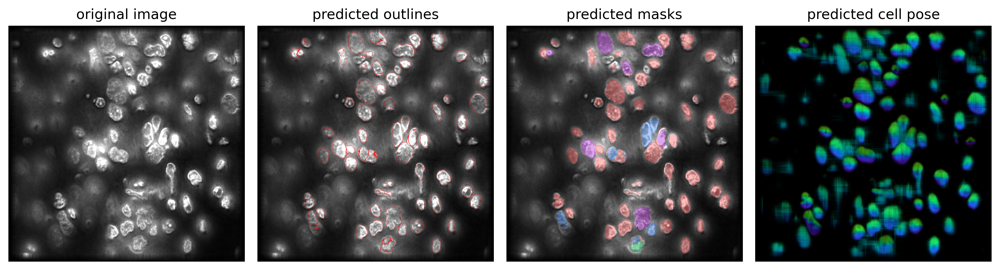

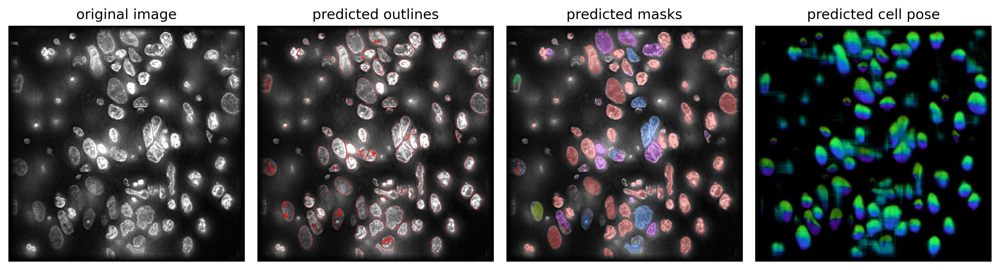

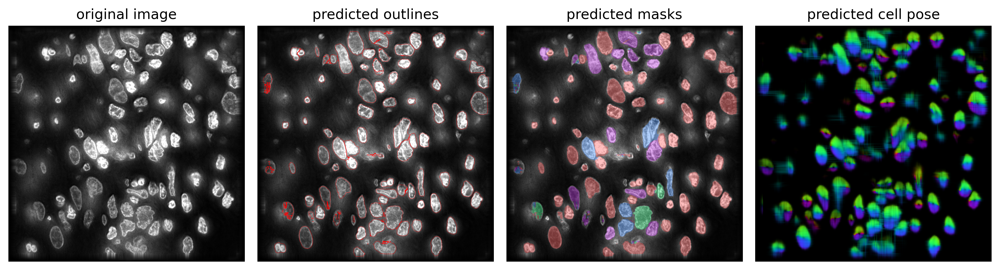

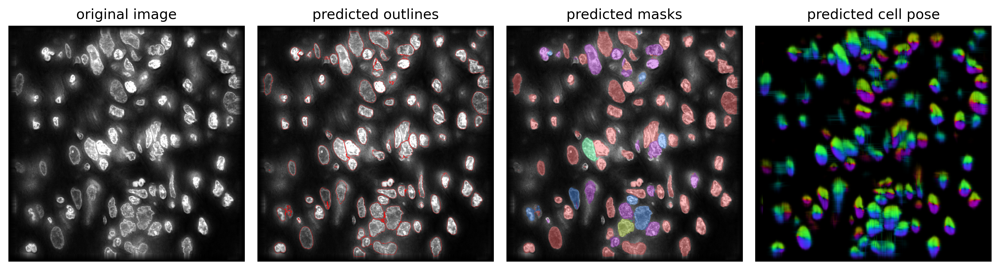

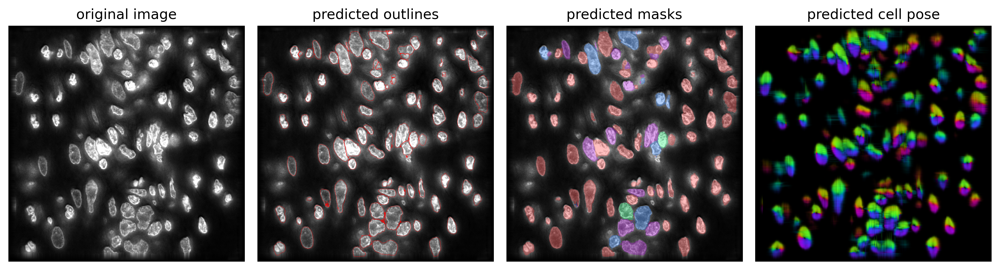

...

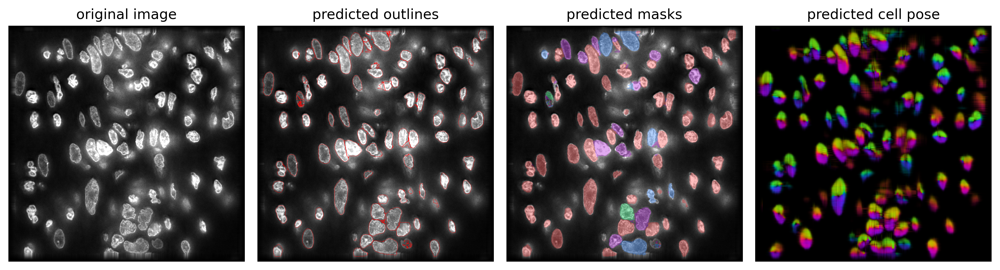

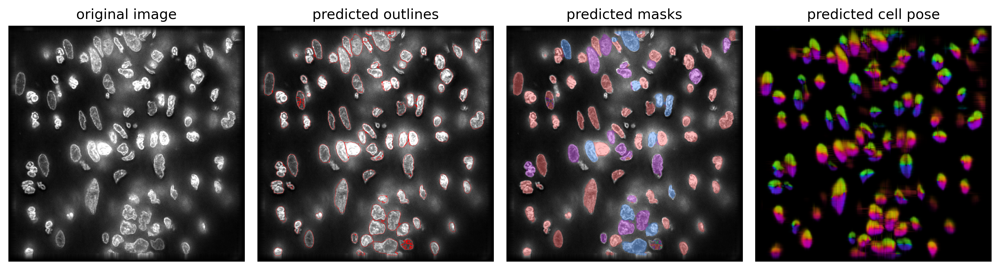

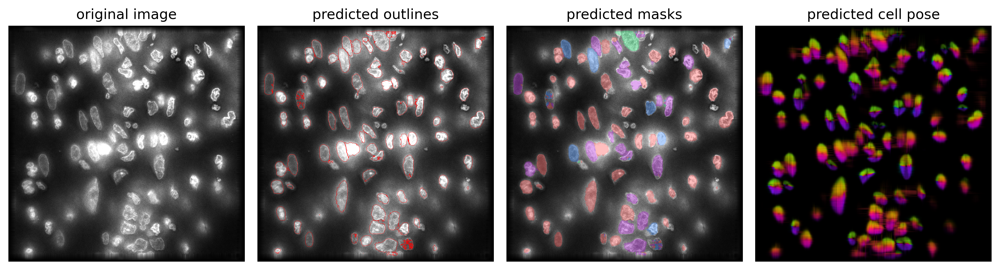

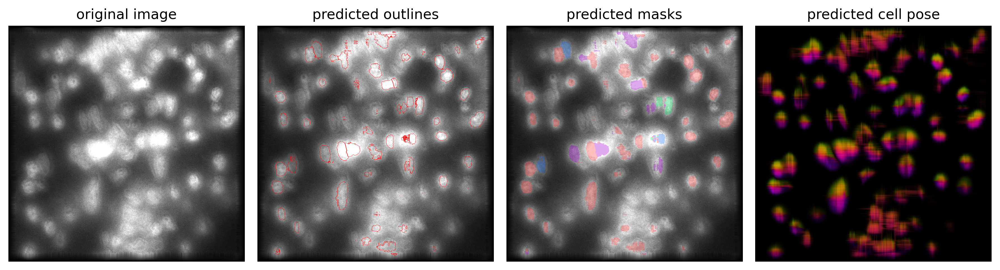

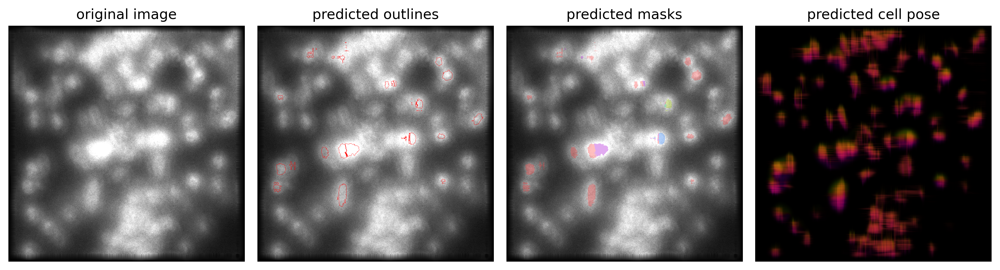

In [ ]:
from cellpose import plot
for i in range(0, len(dna_img), 5):
    fig = plt.figure(figsize=(12,10))
    plot.show_segmentation(fig, dna_img[i], masks[i], flows[0][i],channels=chan)
    plt.tight_layout()

In [ ]:
'''
color_masks = label2rgb(masks)
color_masks = np.moveaxis(color_masks, -1, 0)
color_masks = np.moveaxis(color_masks, 0, 1)
color_masks *= 255
color_masks = np.array(color_masks, dtype="uint16")
print(color_masks.shape, color_masks.max(), color_masks.min())
'''

In [7]:
import numpy as np
import time, os, sys
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300
from cellpose import utils, io
import h5py
import os
from tqdm import tqdm
import tifffile

marker_names = ["DNA1","PD1","TLR3","SOX10","DNA2","CD163",
"CD3D","PDL1","DNA3","CD4","ICOS","HLADPB1","DNA4","CD8A",
"CD68","GZMB","DNA5","CD40L","LAG3","HLAA","DNA6","SQSTM",
"VIN","TIM3","DNA7","LAMP1/CD107A","PDL1_2","PD1_2"]

for i in tqdm(range(1,43)):
    file = "data/{}_R3D_D3D_3D_MERGED.tif".format(i)
    img = io.imread(file)

    from cellpose import models, io
    model = models.Cellpose(gpu=True, model_type='nuclei')
    chan = [0,0]
    img = io.imread(file)
    dna_img = img[20:75,0,:,:]
    masks, flows, styles, diams = model.eval(dna_img, channels=chan, do_3D=True, diameter=85)
    '''
    from cellpose import plot
    for i in range(0, len(dna_img), 5):
        fig = plt.figure(figsize=(12,10))
        plot.show_segmentation(fig, dna_img[i], masks[i], flows[0][i],channels=chan)
        plt.tight_layout()
    '''
    from cellpose import models, io
    model = models.Cellpose(gpu=True, model_type='cyto2')
    chan = [0,1]
    img = io.imread(file)
    dna_img = img[20:75,[0,19],:,:]
    masks2, flows, styles, diams = model.eval(dna_img, channels=chan, do_3D=True, diameter=85)

    '''
    from cellpose import plot
    for i in range(0, len(dna_img), 5):
        fig = plt.figure(figsize=(12,10))
        plot.show_segmentation(fig, dna_img[i], masks[i], flows[0][i],channels=chan)
        plt.tight_layout()
    '''
    img2save = tifffile.imread(file)[20:75,:,:,:]
    img2save_moved = np.moveaxis(img2save, 0, 1)

    masks_moved = np.expand_dims(masks, 1)
    masks_moved = np.moveaxis(masks_moved, 0, 1)

    masks_moved2 = np.expand_dims(masks2, 1)
    masks_moved2 = np.moveaxis(masks_moved2, 0, 1)

    img2save = np.row_stack((img2save_moved, masks_moved))
    img2save = np.row_stack((img2save, masks_moved2))
    img2save = np.row_stack((img2save, np.where(masks_moved > 0, 255, 0)))
    img2save = np.row_stack((img2save, np.where(masks_moved2 > 0, 255, 0)))

    img2save = np.moveaxis(img2save, 0, 1)
    img2save = np.array(img2save, dtype='uint16')
    tifffile.imwrite('data/results/{}'.format(file.split('/')[-1]), img2save, imagej=True, bigtiff=True)

  0%|          | 0/1 [00:00<?, ?it/s]

(86, 28, 1024, 1024) 0 64451
2022-03-28 17:38:24,310 [INFO] ** TORCH CUDA version installed and working. **
2022-03-28 17:38:24,314 [INFO] >>>> using GPU
2022-03-28 17:38:29,009 [INFO] ~~~ FINDING MASKS ~~~
2022-03-28 17:38:29,010 [INFO] multi-stack tiff read in as having 55 planes 1 channels
2022-03-28 17:38:31,666 [INFO] running YX: 55 planes of size (1024, 1024)
2022-03-28 17:38:31,765 [INFO] 
2022-03-28 17:38:31,766 [INFO] 0%|          | 0/2 [00:00<?, ?it/s]
2022-03-28 17:38:31,767 [INFO] 
2022-03-28 17:38:31,913 [INFO] 
2022-03-28 17:38:31,914 [INFO] 50%|#####     | 1/2 [00:00<00:00,  6.92it/s]
2022-03-28 17:38:31,914 [INFO] 
2022-03-28 17:38:32,042 [INFO] 
2022-03-28 17:38:32,043 [INFO] 100%|##########| 2/2 [00:00<00:00,  7.36it/s]
2022-03-28 17:38:32,044 [INFO] 
2022-03-28 17:38:32,046 [INFO] 100%|##########| 2/2 [00:00<00:00,  7.21it/s]
2022-03-28 17:38:32,237 [INFO] 
2022-03-28 17:38:32,238 [INFO] 0%|          | 0/2 [00:00<?, ?it/s]
2022-03-28 17:38:32,239 [INFO] 
2022-03-28 1

/n/home07/ksidak/.conda/envs/cellpose/lib/python3.8/site-packages/tifffile/tifffile.py:1221: UserWarning: <tifffile.TiffWriter '8_R3D_D3D_3D_MERGED.tif'> writing nonconformant BigTIFF ImageJ
  warnings.warn(
100%|██████████| 1/1 [06:04<00:00, 364.01s/it]
